# <font color='#1e3273'>Classification models</font>

This notebook contains several supervised classification models with its performance matrices.

1. **Logistic Regression**
2. **KNN**
3. **Support Vector Machine**
4. **Decision Tree**

### <font color='#18523e'>Business Problem </font>: <i><font color='#305078'>Classifying the bean into different categories according to the features</font></i>

### <font color="#18523e">Domain Analysis</font>

   <ul>
<li>ID - an ID for this instance
<li>Area - (A), The area of a bean zone and the number of pixels within its boundaries.
<li>Perimeter - (P), Bean circumference is defined as the length of its border.
<li>MajorAxisLength - (L), The distance between the ends of the longest line that can be drawn from a bean.
<li>MinorAxisLength - (l), The longest line that can be drawn from the bean while standing perpendicular to the main axis.
<li>AspectRatio - (K), Defines the relationship between L and l.
<li>Eccentricity - (Ec), Eccentricity of the ellipse having the same moments as the region.
<li>ConvexArea - (C), Number of pixels in the smallest convex polygon that can contain the area of a bean seed.
<li>EquivDiameter - (Ed), The diameter of a circle having the same area as a bean seed area.
<li>Extent - (Ex), The ratio of the pixels in the bounding box to the bean area.
<li>Solidity - (S), Also known as convexity. The ratio of the pixels in the convex shell to those found in beans.
<li>Roundness - (R), Calculated with the following formula: (4piA)/(P^2)
<li>Compactness - (CO), Measures the roundness of an object: Ed/L
<li>ShapeFactor1 - (SF1)
<li>ShapeFactor2 - (SF2)
<li>ShapeFactor3 - (SF3)
<li>ShapeFactor4 - (SF4)
<li>Class -  the class of the bean. It can be any of BARBUNYA, SIRA, HOROZ, DERMASON, CALI, BOMBAY, and SEKER.
    </ul>

In [1]:
import pandas as pd
import numpy as np
from scipy import stats

import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import plotly.express as px
import sweetviz
from autoviz.AutoViz_Class import AutoViz_Class

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
from imblearn.over_sampling import SMOTE

from sklearn.model_selection import train_test_split


from sklearn.model_selection import cross_val_score, StratifiedKFold
from sklearn.metrics import make_scorer

from sklearn.model_selection import GridSearchCV

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier


from sklearn.metrics import accuracy_score, f1_score, recall_score, classification_report

%matplotlib inline

Imported v0.1.731. After importing autoviz, execute '%matplotlib inline' to display charts inline.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)


In [2]:
warnings.filterwarnings('ignore')

In [3]:
df = pd.read_excel('Dry_Bean_Dataset.xlsx')

In [4]:
df.head()

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4,Class
0,28395,610.291,208.178117,173.888747,1.197191,0.549812,28715,190.141097,0.763923,0.988856,0.958027,0.913358,0.007332,0.003147,0.834222,0.998724,SEKER
1,28734,638.018,200.524796,182.734419,1.097356,0.411785,29172,191.272750,0.783968,0.984986,0.887034,0.953861,0.006979,0.003564,0.909851,0.998430,SEKER
2,29380,624.110,212.826130,175.931143,1.209713,0.562727,29690,193.410904,0.778113,0.989559,0.947849,0.908774,0.007244,0.003048,0.825871,0.999066,SEKER
3,30008,645.884,210.557999,182.516516,1.153638,0.498616,30724,195.467062,0.782681,0.976696,0.903936,0.928329,0.007017,0.003215,0.861794,0.994199,SEKER
4,30140,620.134,201.847882,190.279279,1.060798,0.333680,30417,195.896503,0.773098,0.990893,0.984877,0.970516,0.006697,0.003665,0.941900,0.999166,SEKER


In [5]:
df.shape

(13611, 17)

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13611 entries, 0 to 13610
Data columns (total 17 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Area             13611 non-null  int64  
 1   Perimeter        13611 non-null  float64
 2   MajorAxisLength  13611 non-null  float64
 3   MinorAxisLength  13611 non-null  float64
 4   AspectRation     13611 non-null  float64
 5   Eccentricity     13611 non-null  float64
 6   ConvexArea       13611 non-null  int64  
 7   EquivDiameter    13611 non-null  float64
 8   Extent           13611 non-null  float64
 9   Solidity         13611 non-null  float64
 10  roundness        13611 non-null  float64
 11  Compactness      13611 non-null  float64
 12  ShapeFactor1     13611 non-null  float64
 13  ShapeFactor2     13611 non-null  float64
 14  ShapeFactor3     13611 non-null  float64
 15  ShapeFactor4     13611 non-null  float64
 16  Class            13611 non-null  object 
dtypes: float64(1

<b>Inference : </b>

No missing values

### <font color='#18523e'> Exploratory Data  Analysis </font>

                                             |                                             | [  0%]   00:00 ->…


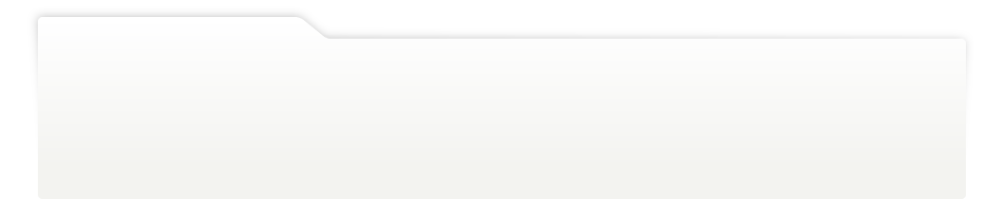
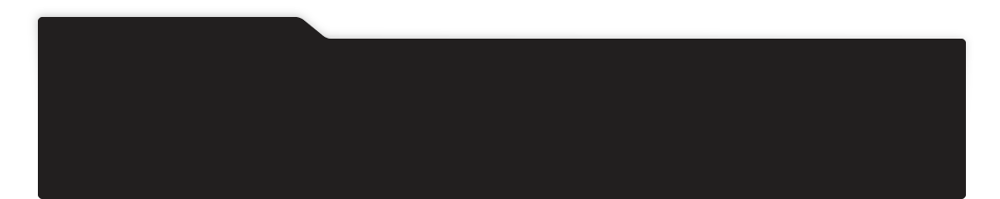
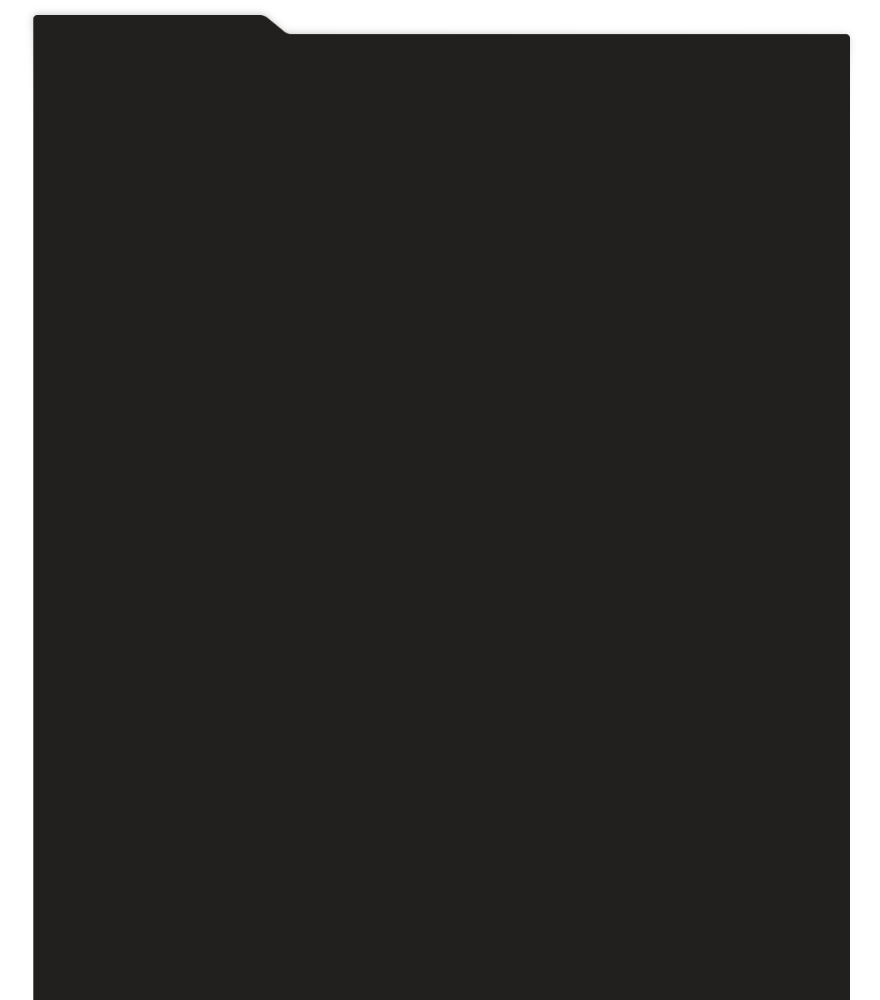
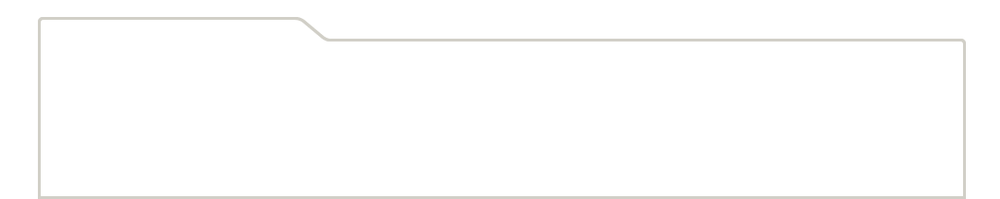
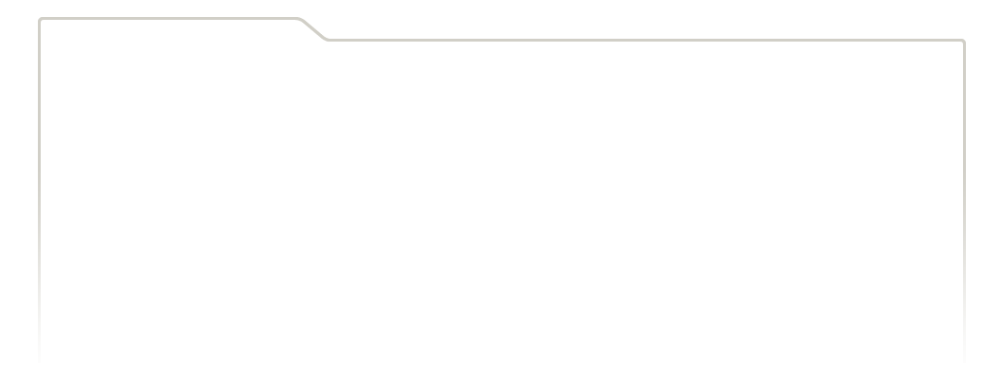
...
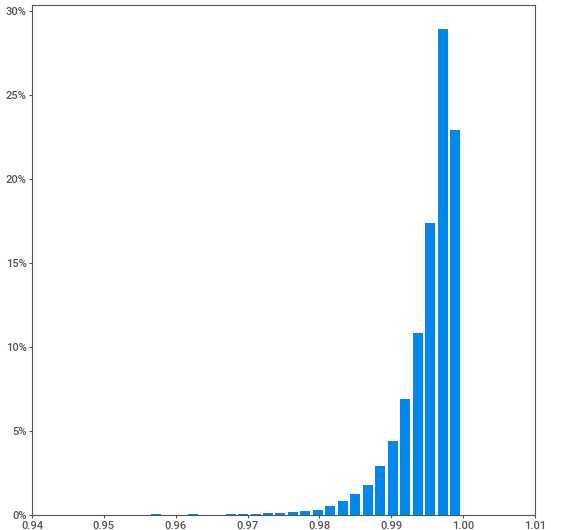
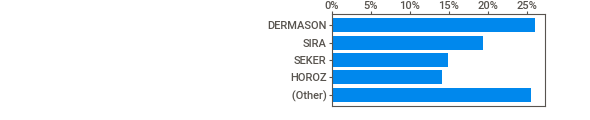
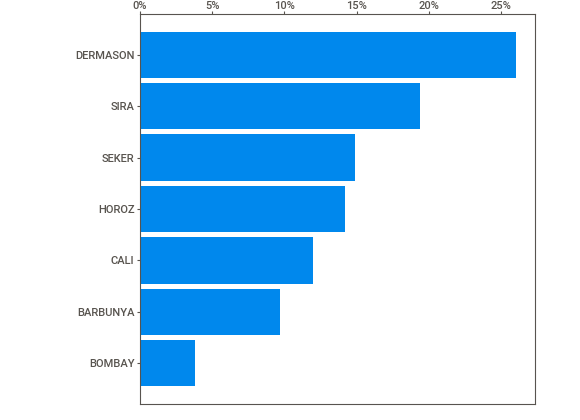
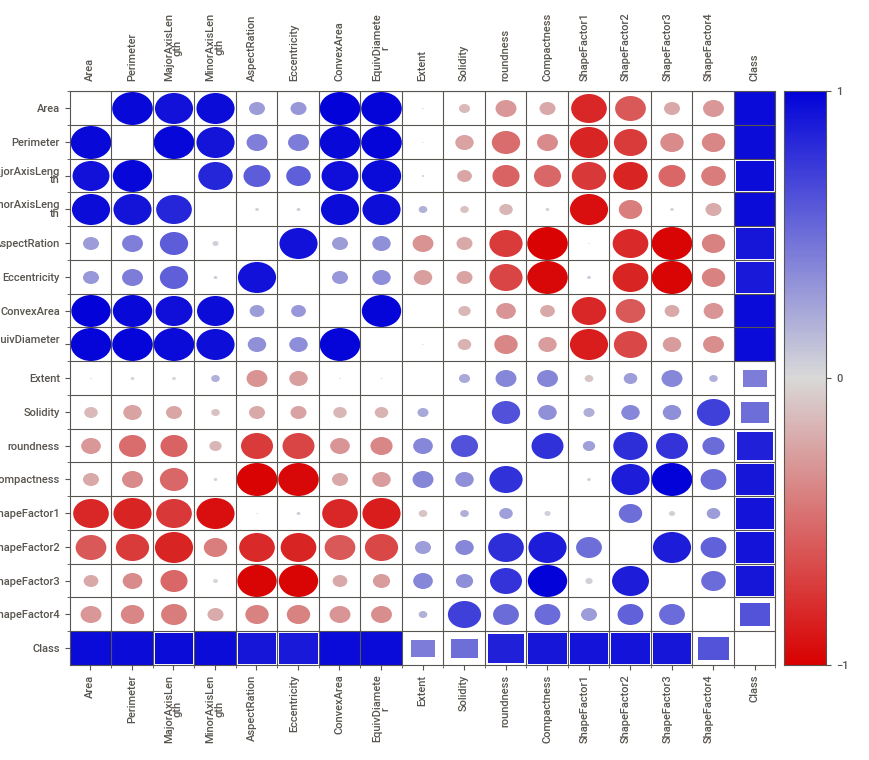
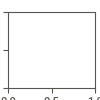

In [7]:
# univariant analysis
sweetviz.analyze(df).show_notebook()


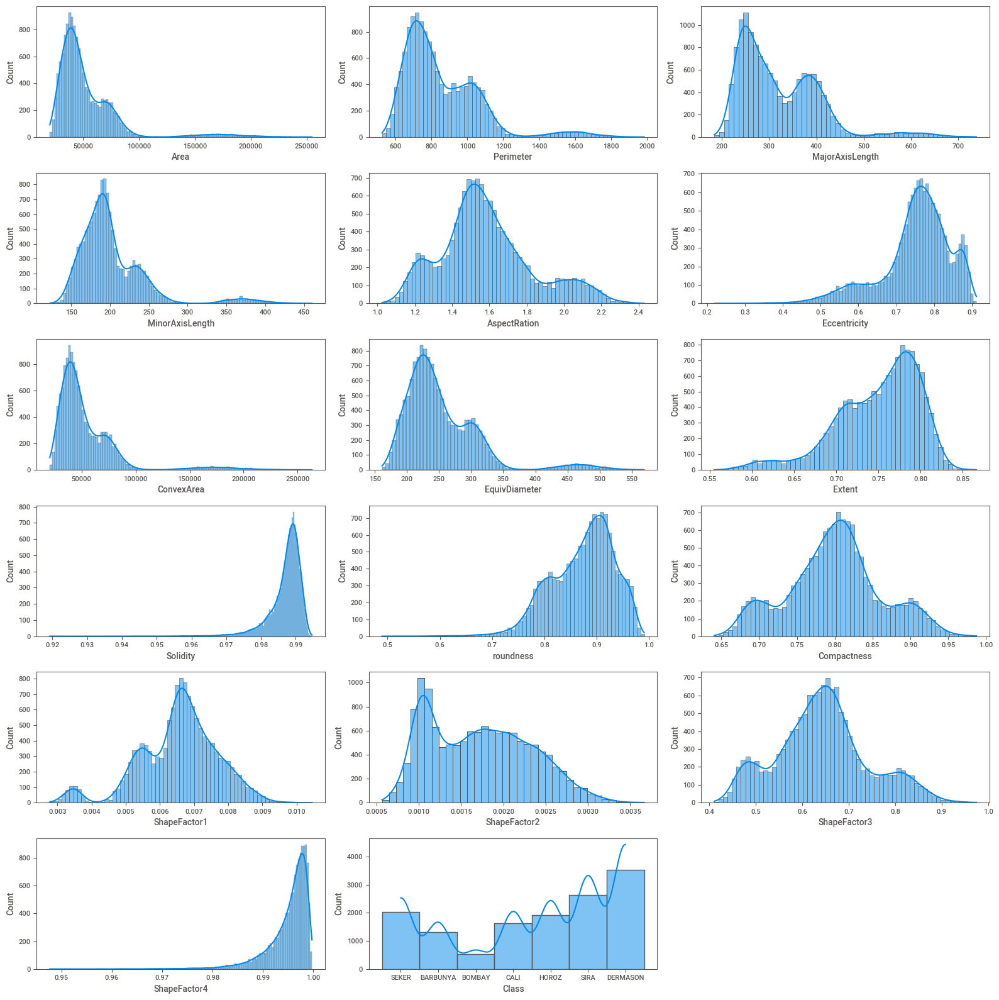

In [8]:
# univariant analysis
plt.figure(figsize=(16,16),facecolor='white')
pltnum =1 
for column in df:
    if pltnum <= 17:
        ax = plt.subplot(6,3,pltnum)
        sns.histplot(x=column,data=df,kde=True)
    pltnum +=1
plt.tight_layout()
plt.show()

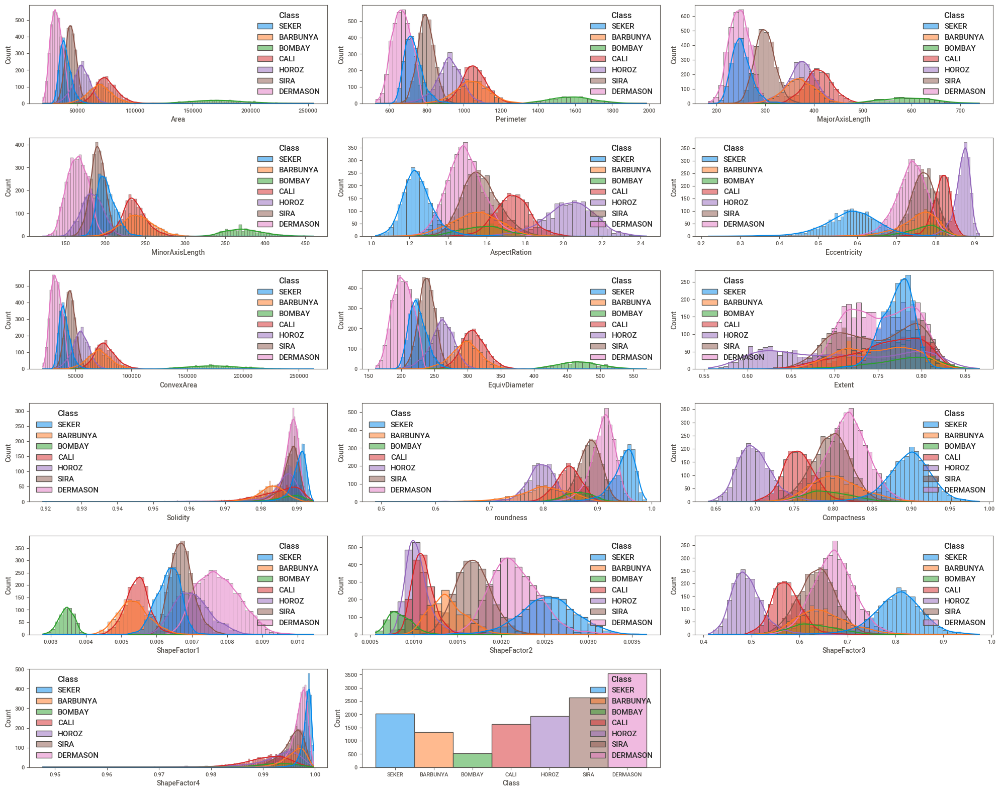

In [9]:
# bivariate analysis
plt.figure(figsize=(20,16),facecolor='white')
pltnum =1 
for column in df:
    if pltnum <= 17:
        ax = plt.subplot(6,3,pltnum)
        sns.histplot(x=column,hue='Class',data=df,kde=True)
    pltnum +=1
plt.tight_layout()
plt.show()

Shape of your Data Set loaded: (13611, 17)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    17 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
To fix data quality issues automatically, import FixDQ from autoviz...
    Alert: Dropping 68 duplicate rows can sometimes cause column data types to change to object. Double-check!


,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
Area,int64,0.000000,88,20420.000000,254616.000000,has 551 outliers greater than upper bound (99031.25) or lower than lower bound(-1366.75). Cap them or remove them.
Perimeter,float64,0.000000,NA,524.736000,1985.370000,"has 500 outliers greater than upper bound (1388.02) or lower than lower bound(292.36). Cap them or remove them., has a high correlation with ['Area']. Consider dropping one of them."
MajorAxisLength,float64,0.000000,NA,183.601165,738.860153,"has 379 outliers greater than upper bound (561.15) or lower than lower bound(68.25). Cap them or remove them., has a high correlation with ['Area', 'Perimeter']. Consider dropping one of them."
MinorAxisLength,float64,0.000000,NA,122.512653,460.198497,"has 567 outliers greater than upper bound (279.28) or lower than lower bound(113.85). Cap them or remove them., has a high correlation with ['Area', 'Perimeter', 'MajorAxisLength']. Consider dropping one of them."
AspectRation,float64,0.000000,NA,1.024868,2.430306,has 485 outliers greater than upper bound (2.11) or lower than lower bound(1.02). Cap them or remove them.
Eccentricity,float64,0.000000,NA,0.218951,0.911423,"has 833 outliers greater than upper bound (0.95) or lower than lower bound(0.57). Cap them or remove them., has a high correlation with ['AspectRation']. Consider dropping one of them."
ConvexArea,int64,0.000000,89,20684.000000,263261.000000,"has 549 outliers greater than upper bound (100890.50) or lower than lower bound(-1857.50). Cap them or remove them., has a high correlation with ['Area', 'Perimeter', 'MajorAxisLength', 'MinorAxisLength']. Consider dropping one of them."
EquivDiameter,float64,0.000000,NA,161.243764,569.374358,"has 526 outliers greater than upper bound (376.50) or lower than lower bound(117.99). Cap them or remove them., has a high correlation with ['Area', 'Perimeter', 'MajorAxisLength', 'MinorAxisLength', 'ConvexArea']. Consider dropping one of them."
Extent,float64,0.000000,NA,0.555315,0.866195,has 271 outliers greater than upper bound (0.89) or lower than lower bound(0.62). Cap them or remove them.
Solidity,float64,0.000000,NA,0.919246,0.994677,has 774 outliers greater than upper bound (1.00) or lower than lower bound(0.98). Cap them or remove them.


Number of All Scatter Plots = 105


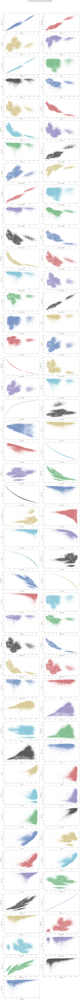

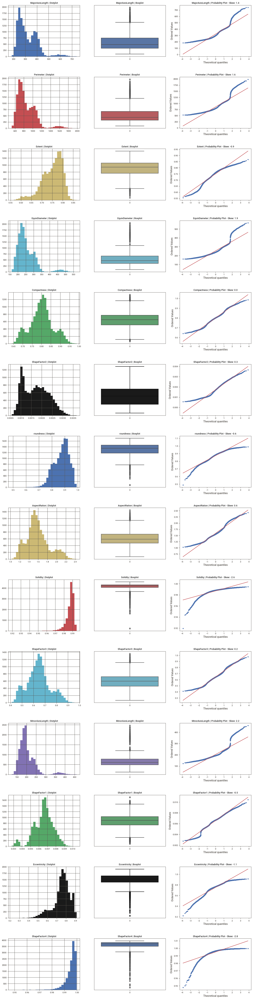

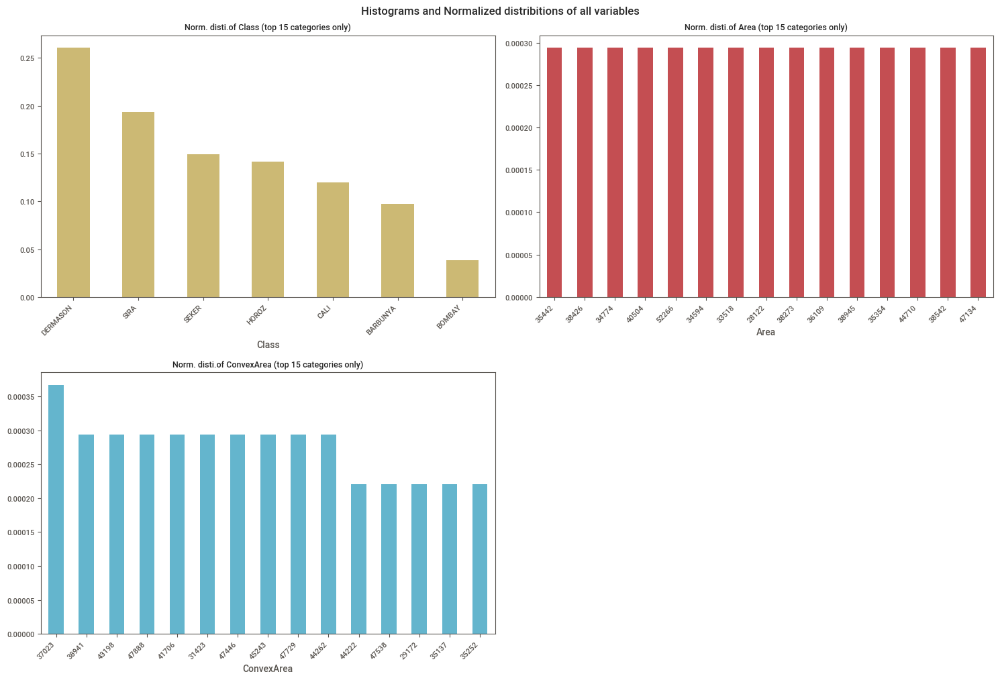

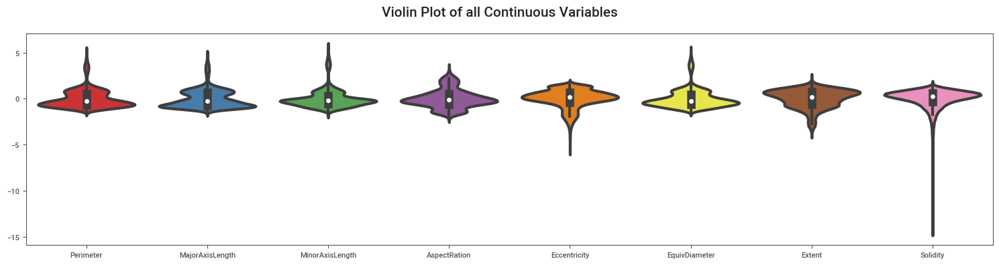

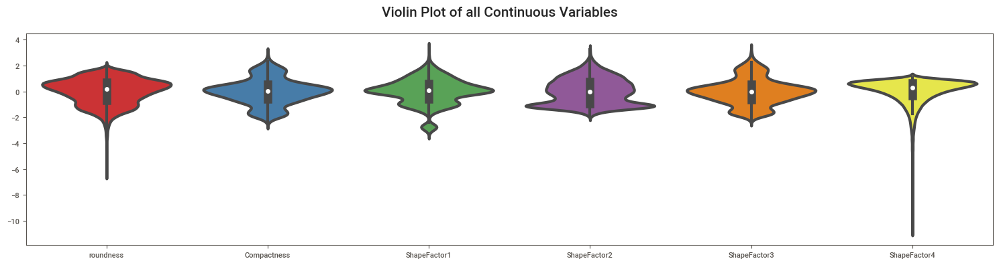

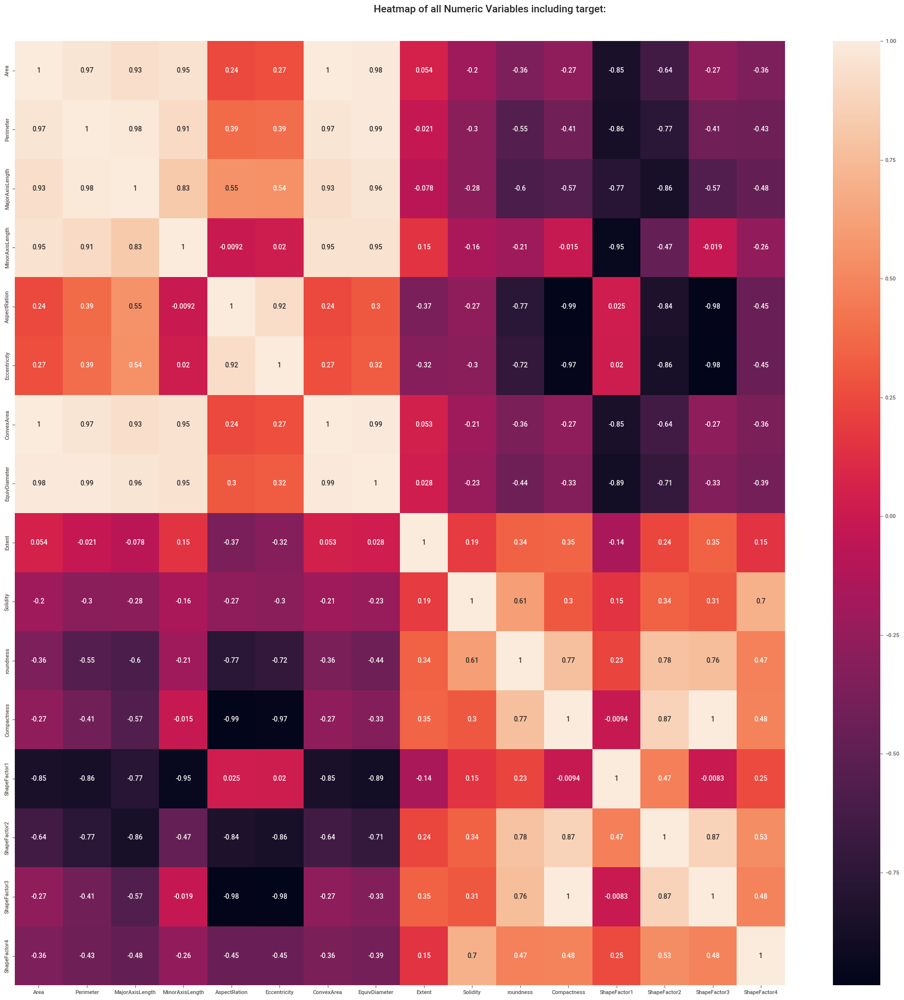

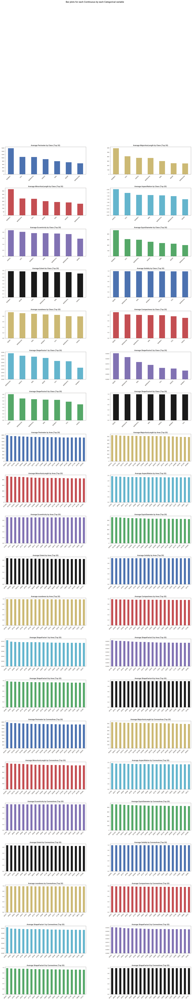

All Plots done
Time to run AutoViz = 38 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


In [10]:
# bivariate analysis
AV = AutoViz_Class()

dfte = AV.AutoViz('Dry_Bean_Dataset.xlsx',sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)

### <font color='#18523e'>Data handling and Preprocessing</font>

**Categorical Encoding using Label encoder**

In [11]:
LB = LabelEncoder()

df['Class'] = LB.fit_transform(df.Class)

In [12]:
df.head(2)

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4,Class
0,28395,610.291,208.178117,173.888747,1.197191,0.549812,28715,190.141097,0.763923,0.988856,0.958027,0.913358,0.007332,0.003147,0.834222,0.998724,5
1,28734,638.018,200.524796,182.734419,1.097356,0.411785,29172,191.272750,0.783968,0.984986,0.887034,0.953861,0.006979,0.003564,0.909851,0.998430,5


**Handling outliers**
```python
for column in df.iloc[:,:-1]:
        df[column] = pd.to_numeric(df[column], errors='coerce')
        lower_bound = df[column].quantile(q=0.25)
        upper_bound = df[column].quantile(q=0.75)
        
        df[column] = df[column].clip(lower=lower_bound, upper=upper_bound)
```
This is how we can cap the outliers but when the outliers were handled, the accuracy score reduced, so resorting transformation
method using yeo-johnson transformation.


In [13]:
for column in df.iloc[:,:-1]:
        IQR = stats.iqr(df[column], interpolation = 'midpoint')

        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)

        min_limit = Q1 - 1.5*IQR
        max_limit = Q3 + 1.5*IQR

        df.loc[df[column] > max_limit, column] = np.median(df[column])
        df.loc[df[column] < min_limit, column] = np.median(df[column])


In [14]:
from scipy.stats import boxcox
df['Area'], lam = boxcox(df['Area'])
df['Perimeter'], lam = boxcox(df['Perimeter'])
df['MajorAxisLength'], lam = boxcox(df['MajorAxisLength'])
df['MinorAxisLength'], lam = boxcox(df['MinorAxisLength'])
df['AspectRation'], lam = boxcox(df['AspectRation'])
df['Eccentricity'], lam = boxcox(df['Eccentricity'])
df['ConvexArea'], lam = boxcox(df['ConvexArea'])
df['EquivDiameter'], lam = boxcox(df['EquivDiameter'])
df['Extent'], lam = boxcox(df['Extent'])
df['Solidity'], lam = boxcox(df['Solidity'])
df['roundness'], lam = boxcox(df['roundness'])
df['Compactness'], lam = boxcox(df['Compactness'])
df['ShapeFactor1'], lam = boxcox(df['ShapeFactor1'])
df['ShapeFactor2'], lam = boxcox(df['ShapeFactor2'])
df['ShapeFactor3'], lam = boxcox(df['ShapeFactor3'])
df['ShapeFactor4'], lam = boxcox(df['ShapeFactor4'])

In [15]:
double_iqr_handle = ['Area','MinorAxisLength','AspectRation','Eccentricity','ConvexArea','EquivDiameter','Extent','Solidity',
                    'Compactness','ShapeFactor1','ShapeFactor3']
for i in range(4):
    for column in double_iqr_handle:
            IQR = stats.iqr(df[column], interpolation = 'midpoint')

            Q1 = df[column].quantile(0.25)
            Q3 = df[column].quantile(0.75)

            min_limit = Q1 - 1.5*IQR
            max_limit = Q3 + 1.5*IQR

            df.loc[df[column] > max_limit, column] = np.median(df[column])
            df.loc[df[column] < min_limit, column] = np.median(df[column])
    i += 1


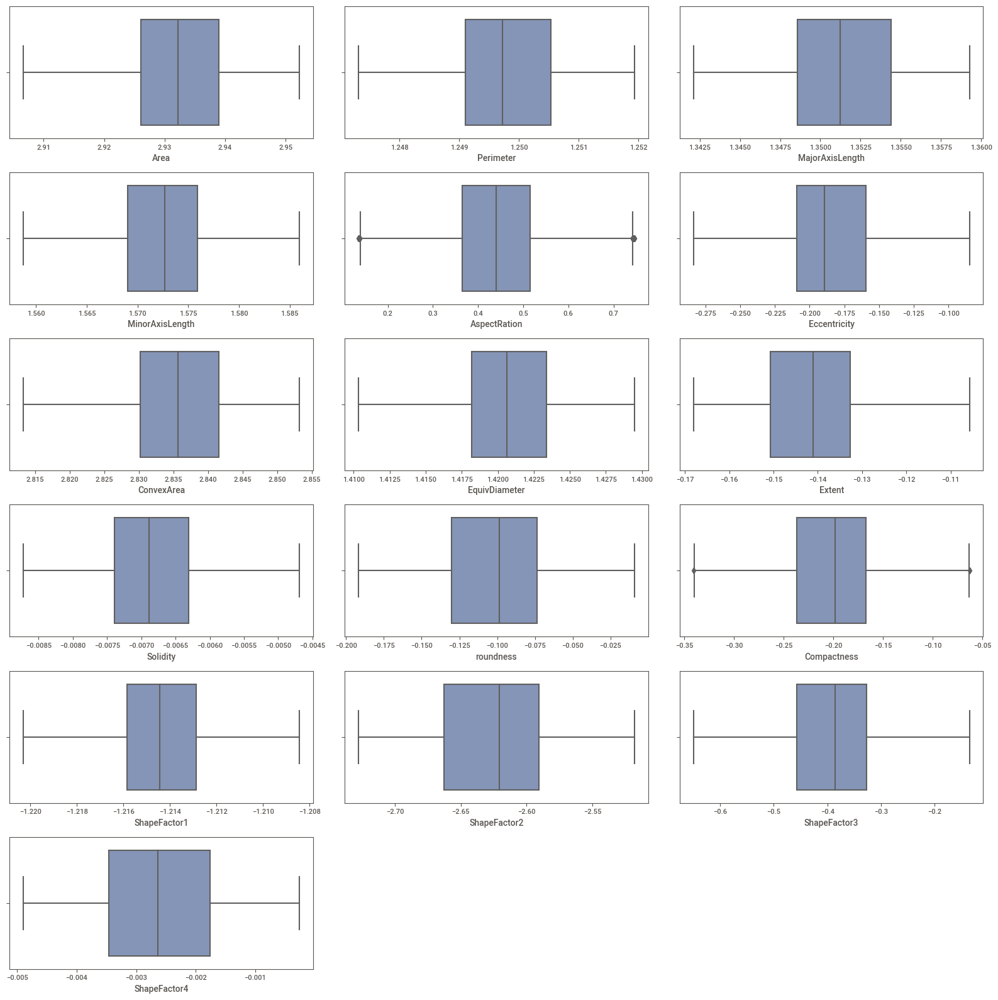

In [16]:
plt.figure(figsize=(16,16),facecolor='white')
pltnum =1 
for column in df:
    if pltnum <= 16:
        ax = plt.subplot(6,3,pltnum)
        sns.boxplot(x=column,data=df,color='#7d92bf')
    pltnum +=1
plt.tight_layout()
plt.show()


**Scaling the data**

In [17]:
x_to_scale = df.iloc[:,:-1]

In [18]:
scale = MinMaxScaler()

df_scaled = scale.fit_transform(x_to_scale)

In [19]:
df_sc = pd.DataFrame(df_scaled,columns=['Area', 'Perimeter', 'MajorAxisLength', 'MinorAxisLength',
       'AspectRation', 'Eccentricity', 'ConvexArea', 'EquivDiameter', 'Extent',
       'Solidity', 'roundness', 'Compactness', 'ShapeFactor1', 'ShapeFactor2',
       'ShapeFactor3', 'ShapeFactor4'])
df_sc

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4
0,0.251000,0.210428,0.157087,0.357501,0.073667,0.473279,0.251629,0.242161,0.452557,0.499774,0.833938,0.915118,0.643111,0.893035,0.930888,0.810888
1,0.259708,0.267663,0.111746,0.434709,0.498511,0.473279,0.263197,0.250545,0.553052,0.240485,0.524870,0.512555,0.566751,0.979887,0.513971,0.762111
2,0.275930,0.239524,0.183243,0.375881,0.090718,0.473279,0.276018,0.266158,0.522470,0.558747,0.785385,0.898633,0.624221,0.871150,0.913526,0.871175
3,0.291250,0.283094,0.170604,0.432879,0.012948,0.473279,0.300735,0.280900,0.546241,0.454697,0.592368,0.968973,0.575025,0.907565,0.987775,0.286563
4,0.294417,0.231272,0.119796,0.495957,0.498511,0.473279,0.293514,0.283946,0.497092,0.682930,0.969294,0.512555,0.505269,1.000000,0.513971,0.889502
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13606,0.522407,0.473897,0.504596,0.461259,0.500208,0.475039,0.521215,0.502836,0.251187,0.628584,0.645374,0.514665,0.540577,0.528225,0.516118,0.754851
13607,0.522468,0.470704,0.480800,0.499361,0.417503,0.386210,0.521004,0.502895,0.641948,0.668944,0.668671,0.587806,0.503320,0.571034,0.590756,0.728536
13608,0.523050,0.473354,0.480676,0.503071,0.413209,0.381426,0.522136,0.503453,0.307421,0.588814,0.653169,0.589519,0.501808,0.571778,0.592511,0.530369
13609,0.523173,0.479788,0.486914,0.495930,0.431767,0.401981,0.523610,0.503570,0.220080,0.419594,0.608755,0.570601,0.511111,0.560646,0.573153,0.370183


<Axes: >

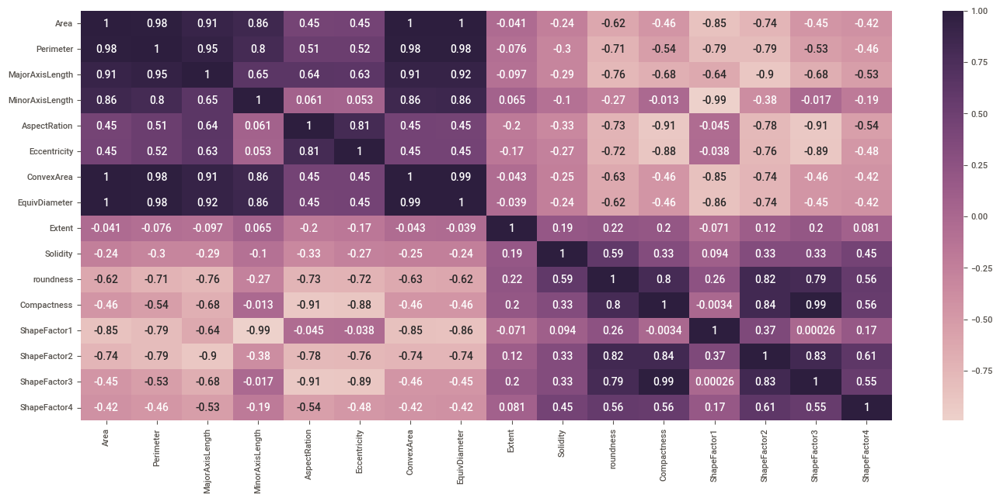

In [20]:
plt.figure(figsize=(15,7))
sns.heatmap(df_sc.corr(),annot=True,cmap=sns.cubehelix_palette(as_cmap=True))

**Feature Extraction**

In [21]:
from sklearn.decomposition import PCA

Text(0.5, 1.0, 'Explained Variance')

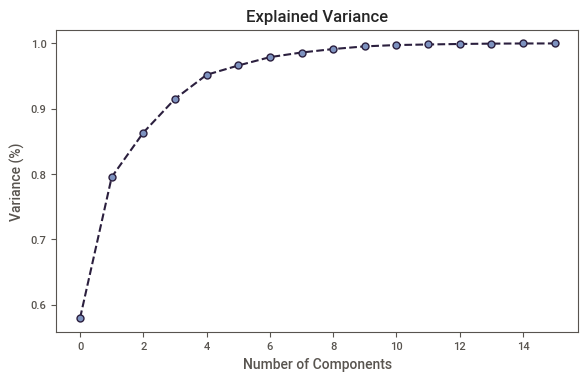

In [22]:
pca = PCA()

principalComponents = pca.fit_transform(df_sc)

plt.plot(np.cumsum(pca.explained_variance_ratio_),color='#2b1f3e', linestyle='dashed', 
         marker='o',markerfacecolor='#7d92bf', markersize=5)
plt.xlabel('Number of Components')
plt.ylabel('Variance (%)') #for each component
plt.title('Explained Variance')

In [23]:
pca = PCA(n_components=9)
new_data = pca.fit_transform(df_sc)


# This will be the new data fed to the algorithm.
principal_Df = pd.DataFrame(data = new_data
             , columns = ['pc1', 'pc2','pc3','pc4','pc5','pc6','pc7','pc8','pc9'])

In [24]:
principal_Df.head()

,pc1,pc2,pc3,pc4,pc5,pc6,pc7,pc8,pc9
0,1.158862,-0.077816,0.071367,-0.068736,0.079141,0.014250,0.323278,0.008732,0.103282
1,0.675238,0.276951,0.127900,-0.045703,0.353989,-0.302617,0.168077,0.243137,-0.174272
2,1.107761,-0.117989,-0.021955,-0.042323,0.135223,0.038866,0.289918,0.043583,0.102492
3,0.923839,-0.131831,0.414247,0.229431,-0.114272,0.151982,0.368305,0.236245,0.105988
4,0.856130,0.082224,-0.320521,-0.050668,0.047385,-0.455976,0.208986,0.062982,-0.214359


In [25]:
principal_Df.shape

(13611, 9)

<Axes: >

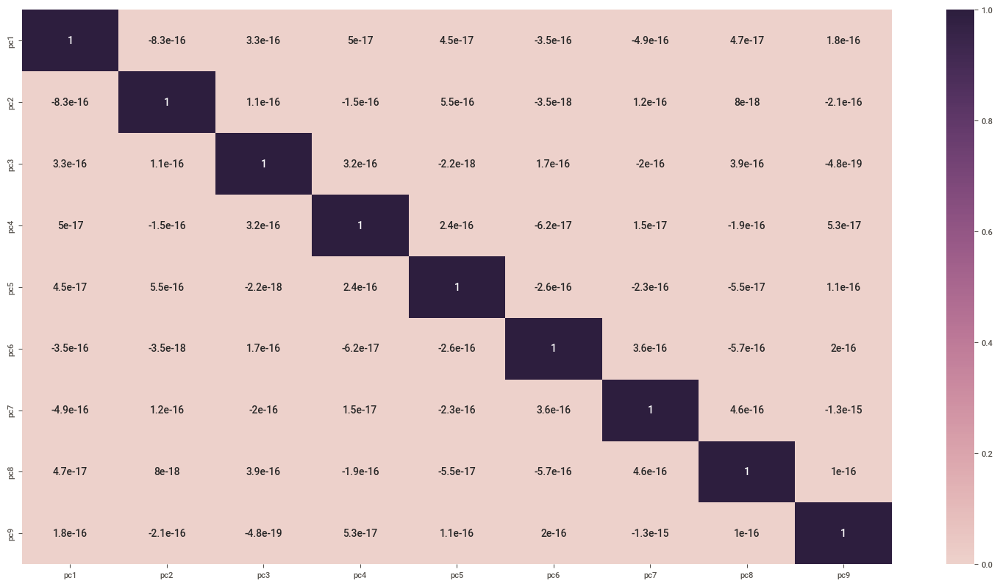

In [26]:
plt.figure(figsize=(17,10))
sns.heatmap(principal_Df.corr(),annot=True,cmap=sns.cubehelix_palette(as_cmap=True))

## <font color='#18523e'>Model Creation</font>

In [27]:
x = principal_Df
y = df['Class']

In [28]:
x_train, x_test, y_train, y_test = train_test_split(x,y,train_size=0.2,random_state=42)

**Balancing the data**

In [29]:
df.Class.value_counts()

Class
3    3546
6    2636
5    2027
4    1928
2    1630
0    1322
1     522
Name: count, dtype: int64

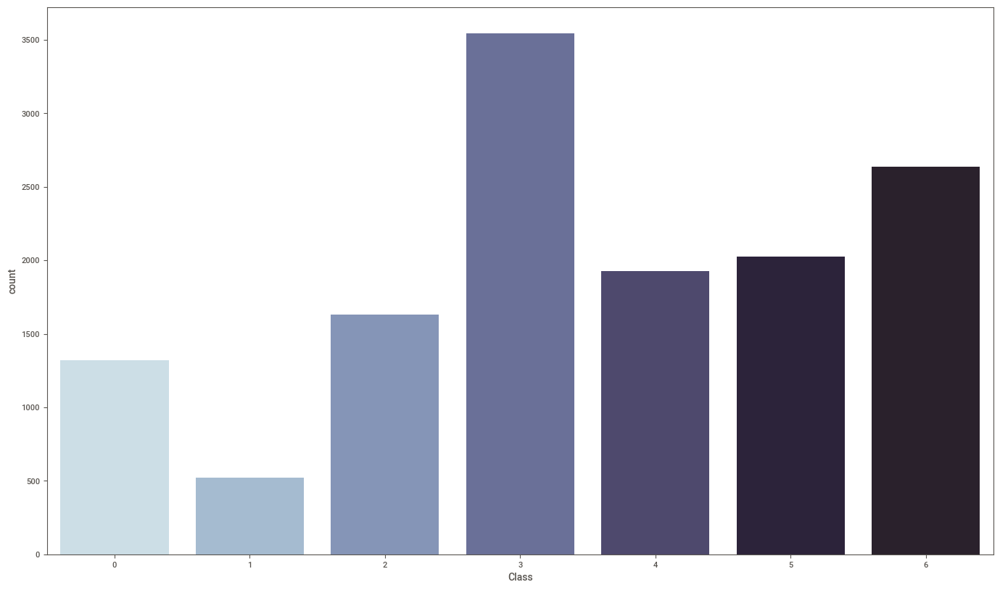

In [30]:
plt.figure(figsize=(15,10))
sns.countplot(x='Class',data=df,palette=['#c7dfeb', '#9ebbd7', '#7d92bf', '#636a9f', '#494373', '#2b1f3e','#2b1f2e'])
plt.show()

In [31]:
oversample = SMOTE(random_state=42)

x_sampled,y_sampled = oversample.fit_resample(x_train,y_train)

In [32]:
x_sampled.shape

(5117, 9)

In [33]:
y_sampled.value_counts()

Class
4    731
2    731
6    731
5    731
3    731
1    731
0    731
Name: count, dtype: int64

In [34]:
sampled_df = pd.concat([x_sampled,y_sampled],axis=1)

In [35]:
print(sns.color_palette("ch:s=.25,rot=-.25").as_hex())

['#c7dfeb', '#9ebbd7', '#7d92bf', '#636a9f', '#494373', '#2b1f3e']


<Axes: xlabel='Class', ylabel='count'>

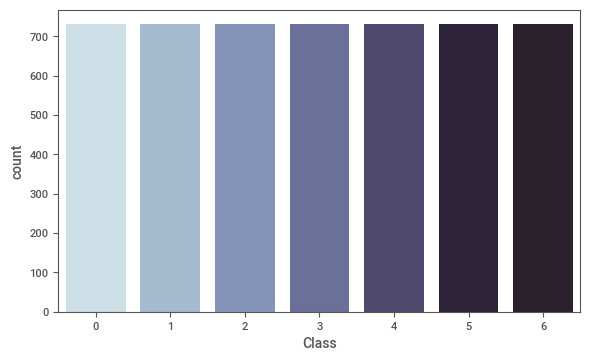

In [36]:
sns.countplot(x='Class',data=sampled_df, palette=['#c7dfeb', '#9ebbd7', '#7d92bf', '#636a9f', '#494373', '#2b1f3e','#2b1f2e'])

In [37]:
f1_scorer = make_scorer(f1_score, average='weighted', pos_label=1)
cv = StratifiedKFold(n_splits=7, shuffle=True, random_state=3)

In [38]:
def run_multiple_algorithms(x_train,y_train, x_test, y_test, models):
    results = {}
    for model_name, model in models.items():
        model.fit(x_train,y_train)
        y_pred = model.predict(x_test)
        y_pre_train = model.predict(x_train)
        accuracy = accuracy_score(y_test,y_pred)
        f1_test = f1_score(y_test,y_pred,average='weighted')
        f1_train = f1_score(y_train,y_pre_train,average='weighted')
        recall = recall_score(y_test,y_pred,average='weighted')
        cv_scores = cross_val_score(model, x, y, cv=cv, scoring=f1_scorer).mean()
        cv_score_mean = cross_val_score(model, x, y, cv=cv, scoring=f1_scorer).std()
        
        results[model_name] = {
            'accuracy' : accuracy,
            'f1 train score' : f1_train,
            'f1 test score' : f1_test,
            'recall score': recall,
            'cross_val_scores' : cv_scores,
            'cross_val_std' : cv_score_mean
        }
        
    return results

In [39]:
models_to_run = {
    'Logistic Regression': LogisticRegression(),
    'KNN':KNeighborsClassifier(),
    'SVM': SVC(),
    'Decision Tree' : DecisionTreeClassifier(),
    'Random Forest': RandomForestClassifier(),
        
}

results = run_multiple_algorithms(x_train,y_train,x_test,y_test, models_to_run)

for model, scores in results.items():
    print(f'Model : {model}')
    print(f"Accuracy : {scores['accuracy']}")
    print(f"F1_score for training dataset: {scores['f1 train score']}")
    print(f"F1_score for testing dataset: {scores['f1 test score']}")
    print(f"Recall score : {scores['recall score']}")
    print(f"Cross-validation scores : {scores['cross_val_scores']}")
    print(f"Cross-validation std : {scores['cross_val_std']}")
    print('='*50)

Model : Logistic Regression
Accuracy : 0.9057764716686565
F1_score for training dataset: 0.911955582661289
F1_score for testing dataset: 0.9057050870531033
Recall score : 0.9057764716686565
Cross-validation scores : 0.9141264449688907
Cross-validation std : 0.0052749537656071885
Model : KNN
Accuracy : 0.9063274864542199
F1_score for training dataset: 0.9279739546529001
F1_score for testing dataset: 0.9062831190504217
Recall score : 0.9063274864542199
Cross-validation scores : 0.9158102369561233
Cross-validation std : 0.00660167882448189
Model : SVM
Accuracy : 0.9200110202957112
F1_score for training dataset: 0.926573289349067
F1_score for testing dataset: 0.9199583496865801
Recall score : 0.9200110202957112
Cross-validation scores : 0.9239021994980706
Cross-validation std : 0.006794217367451745
Model : Decision Tree
Accuracy : 0.87244007714207
F1_score for training dataset: 1.0
F1_score for testing dataset: 0.8722855930654787
Recall score : 0.87244007714207
Cross-validation scores : 0.

**Hyperparametric Tuning**

In [40]:
params = {'SVC' : {'C': [0.1, 1, 10, 100, 1000], 
                   'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
                   'kernel': ['linear','poly','rbf','sigmoid']
                  },
          'Decision Tree' : {
                    "criterion":("gini", "entropy"), 
                    "splitter":("best", "random"), 
                    "max_depth":list(range(1, 20)), 
                    "min_samples_split":[2,3,5,7,9],    
                    "min_samples_leaf":list(range(1, 20))
                            }
         }

hyper_models = {'SVC': SVC(),
                'Decision Tree': DecisionTreeClassifier()
               }

best_params = {}

for model_name, model in hyper_models.items():
    grid = GridSearchCV(model,params[model_name], verbose = 1,scoring='f1_weighted', n_jobs=-1, cv = cv)
    grid.fit(x_train,y_train)
    best_params[model_name] = grid.best_params_
    print(f'Model : {model}')
    print(f'Best Parameters : {grid.best_params_}')
    print(f'Best Estimator : {grid.best_estimator_}')
    print("Test Set Score: {:.2f}".format(grid.score(x_test, y_test)))
    print('='*50)


Fitting 7 folds for each of 100 candidates, totalling 700 fits
Model : SVC()
Best Parameters : {'C': 100, 'gamma': 0.1, 'kernel': 'rbf'}
Best Estimator : SVC(C=100, gamma=0.1)
Test Set Score: 0.92
Fitting 7 folds for each of 7220 candidates, totalling 50540 fits
Model : DecisionTreeClassifier()
Best Parameters : {'criterion': 'gini', 'max_depth': 7, 'min_samples_leaf': 1, 'min_samples_split': 2, 'splitter': 'best'}
Best Estimator : DecisionTreeClassifier(max_depth=7)
Test Set Score: 0.88


In [48]:
new_models = {'SVM' : SVC(C = best_params['SVC']['C'], gamma = best_params['SVC']['gamma'], 
                          kernel = best_params['SVC']['kernel']),
              'Decision Tree': DecisionTreeClassifier(criterion = best_params['Decision Tree']['criterion'], 
                                                      max_depth = best_params['Decision Tree']['max_depth'], 
                                                      min_samples_leaf = best_params['Decision Tree']['min_samples_leaf'], 
                                                      min_samples_split = best_params['Decision Tree']['min_samples_split'], 
                                                      splitter = best_params['Decision Tree']['splitter']
                                                     )
             }

results_hyp = run_multiple_algorithms(x_train,y_train,x_test,y_test, new_models)

print('After hyperparametric tuning: \n')
for model, scores in results_hyp.items():
    print(f'Model : {model}')
    print(f"Accuracy : {scores['accuracy']}")
    print(f"F1_score for training dataset: {scores['f1 train score']}")
    print(f"F1_score for testing dataset: {scores['f1 test score']}")
    print(f"Recall score : {scores['recall score']}")
    print(f"Cross-validation scores : {scores['cross_val_scores']}")
    print(f"Cross-validation std : {scores['cross_val_std']}")
    print('='*50)

After hyperparametric tuning: 

Model : SVM
Accuracy : 0.9205620350812747
F1_score for training dataset: 0.9250479073238913
F1_score for testing dataset: 0.9205000094965624
Recall score : 0.9205620350812747
Cross-validation scores : 0.9225522457873135
Cross-validation std : 0.0067507133857302335
Model : Decision Tree
Accuracy : 0.8798787767471761
F1_score for training dataset: 0.9384499530173714
F1_score for testing dataset: 0.8792852877537992
Recall score : 0.8798787767471761
Cross-validation scores : 0.8972737124673943
Cross-validation std : 0.0069733888864678345


**RandomForest Implementation(decision tree ensembling)**

*Hyperparametric tuning*

In [42]:
from sklearn.model_selection import RandomizedSearchCV

n_estimators = [int(x) for x in np.linspace(start=200, stop=2000, num=10)]       
max_features = ['log2', 'sqrt']                                  
max_depth = [int(x) for x in np.linspace(10, 110, num=11)]      
min_samples_split = [2, 5, 10]
min_samples_leaf = [1, 2, 4]

random_grid = {'n_estimators': n_estimators, 'max_features': max_features,
               'max_depth': max_depth, 'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf}

rf_cv = RandomizedSearchCV(estimator = RandomForestClassifier(), 
                           scoring = 'f1_weighted',
                           param_distributions = random_grid, 
                           n_iter=100, cv=5, 
                           verbose=2, random_state=3, n_jobs=-1)

rf_cv.fit(x_sampled, y_sampled)                                  
rf_best_params = rf_cv.best_params_                          
print(f"Best paramters: {rf_best_params})") 

Fitting 5 folds for each of 100 candidates, totalling 500 fits
Best paramters: {'n_estimators': 200, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': 60})


In [43]:
rf_clf2 = RandomForestClassifier(n_estimators= rf_best_params['n_estimators'], 
                                 min_samples_split = rf_best_params['min_samples_split'],
                                 min_samples_leaf =  rf_best_params['min_samples_leaf'], 
                                 max_features =  rf_best_params['max_features'], 
                                 max_depth = rf_best_params['max_depth'] )
rf_clf2.fit(x_sampled, y_sampled)
print('After hyperparametric tuning: \n')
print(f'Model : Random Forest')
print(f"Accuracy : {accuracy_score(y_test,rf_clf2.predict(x_test))}")
print(f"F1_score for training dataset: {f1_score(y_train,rf_clf2.predict(x_train),average='weighted')}")
print(f"F1_score for testing dataset: {f1_score(y_test,rf_clf2.predict(x_test),average='weighted')}")
print(f"Recall score : {recall_score(y_test,rf_clf2.predict(x_test),average='weighted')}")
print(f"Cross-validation scores : {cross_val_score(rf_clf2,x,y,cv=cv,scoring=f1_scorer).mean()}")
print(f"Cross-validation std : {cross_val_score(rf_clf2,x,y,cv=cv,scoring=f1_scorer).std()}")
print('='*50)


After hyperparametric tuning: 

Model : Random Forest
Accuracy : 0.9128478280833869
F1_score for training dataset: 1.0
F1_score for testing dataset: 0.9125976522684358
Recall score : 0.9128478280833869
Cross-validation scores : 0.9241013343172314
Cross-validation std : 0.007465882894480715


In [44]:
test_score_rfc = rf_clf2.score(x_test, y_test)
print("Test Set Score: {:.2f}".format(test_score_rfc))

Test Set Score: 0.91


### Plot of f1 scores of different models

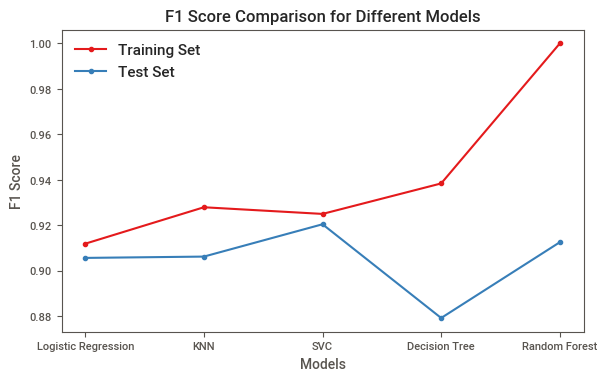

In [49]:
f1_list_train = [results['Logistic Regression']['f1 train score'],
                 results['KNN']['f1 train score'],
                 results_hyp['SVM']['f1 train score'],
                 results_hyp['Decision Tree']['f1 train score'],
                 f1_score(y_train,rf_clf2.predict(x_train),average='weighted')]
f1_list_test = [results['Logistic Regression']['f1 test score'],
                 results['KNN']['f1 test score'],
                 results_hyp['SVM']['f1 test score'],
                 results_hyp['Decision Tree']['f1 test score'],
                 f1_score(y_test,rf_clf2.predict(x_test),average='weighted')]

models = ['Logistic Regression', 'KNN', 'SVC', 'Decision Tree', 'Random Forest']

plt.plot(models, f1_list_train, marker='o', label='Training Set')
plt.plot(models, f1_list_test, marker='o', label='Test Set')

plt.xlabel('Models')
plt.ylabel('F1 Score')
plt.title('F1 Score Comparison for Different Models')
plt.legend()  

plt.show()

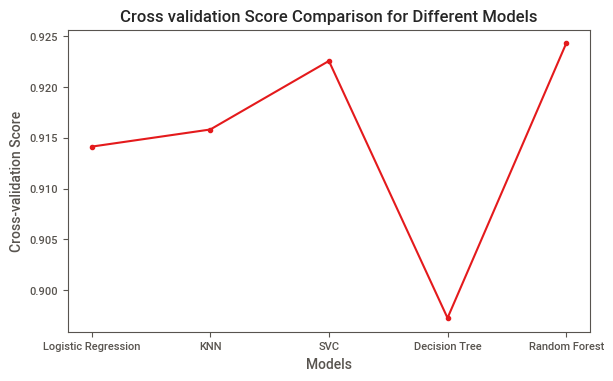

In [50]:
cross_val_list = [results['Logistic Regression']['cross_val_scores'],
                  results['KNN']['cross_val_scores'],
                  results_hyp['SVM']['cross_val_scores'],
                  results_hyp['Decision Tree']['cross_val_scores'],
                  cross_val_score(rf_clf2,x,y,cv=cv,scoring=f1_scorer).mean()]

plt.plot(models, cross_val_list, marker='o')
plt.xlabel('Models')
plt.ylabel('Cross-validation Score')
plt.title('Cross validation Score Comparison for Different Models')

plt.show()

**Comparing all the 5 models, SVC is better for this analysis**